In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
cancer_data = pd.read_csv("/content/drive/MyDrive/data.csv")
# print(cancer_data.head(10))
print(cancer_data.head(10))

         id diagnosis  radius_mean  texture_mean  perimeter_mean  area_mean  \
0    842302         M        17.99         10.38          122.80     1001.0   
1    842517         M        20.57         17.77          132.90     1326.0   
2  84300903         M        19.69         21.25          130.00     1203.0   
3  84348301         M        11.42         20.38           77.58      386.1   
4  84358402         M        20.29         14.34          135.10     1297.0   
5    843786         M        12.45         15.70           82.57      477.1   
6    844359         M        18.25         19.98          119.60     1040.0   
7  84458202         M        13.71         20.83           90.20      577.9   
8    844981         M        13.00         21.82           87.50      519.8   
9  84501001         M        12.46         24.04           83.97      475.9   

   smoothness_mean  compactness_mean  concavity_mean  concave points_mean  \
0          0.11840           0.27760         0.30010 

**Benign= 0 , Malignant = 1**

**Encode Categorical Data:**
If your target variable "Diagnosis" is categorical (M or B), you can encode it to numerical values. For example, you can use LabelEncoder from scikit-learn

In [ ]:
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
cancer_data['diagnosis'] = label_encoder.fit_transform(cancer_data['diagnosis'])
print(cancer_data.tail(10))

         id  diagnosis  radius_mean  texture_mean  perimeter_mean  area_mean  \
559  925291          0        11.51         23.93           74.52      403.5   
560  925292          0        14.05         27.15           91.38      600.4   
561  925311          0        11.20         29.37           70.67      386.0   
562  925622          1        15.22         30.62          103.40      716.9   
563  926125          1        20.92         25.09          143.00     1347.0   
564  926424          1        21.56         22.39          142.00     1479.0   
565  926682          1        20.13         28.25          131.20     1261.0   
566  926954          1        16.60         28.08          108.30      858.1   
567  927241          1        20.60         29.33          140.10     1265.0   
568   92751          0         7.76         24.54           47.92      181.0   

     smoothness_mean  compactness_mean  concavity_mean  concave points_mean  \
559          0.09261           0.10210  

In [ ]:
cancer_data= cancer_data.drop(['id', 'Unnamed: 32'], axis=1)

In [ ]:
# Display basic information about the dataset
print("Dataset Info:")
print(cancer_data.info())

# Display summary statistics for numerical features
print("\nSummary Statistics:")
print(cancer_data.describe())

Dataset Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 31 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   diagnosis                569 non-null    int64  
 1   radius_mean              569 non-null    float64
 2   texture_mean             569 non-null    float64
 3   perimeter_mean           569 non-null    float64
 4   area_mean                569 non-null    float64
 5   smoothness_mean          569 non-null    float64
 6   compactness_mean         569 non-null    float64
 7   concavity_mean           569 non-null    float64
 8   concave points_mean      569 non-null    float64
 9   symmetry_mean            569 non-null    float64
 10  fractal_dimension_mean   569 non-null    float64
 11  radius_se                569 non-null    float64
 12  texture_se               569 non-null    float64
 13  perimeter_se             569 non-null    float64
 14  area_se     

In [ ]:
print(cancer_data.isnull().sum())

diagnosis                  0
radius_mean                0
texture_mean               0
perimeter_mean             0
area_mean                  0
smoothness_mean            0
compactness_mean           0
concavity_mean             0
concave points_mean        0
symmetry_mean              0
fractal_dimension_mean     0
radius_se                  0
texture_se                 0
perimeter_se               0
area_se                    0
smoothness_se              0
compactness_se             0
concavity_se               0
concave points_se          0
symmetry_se                0
fractal_dimension_se       0
radius_worst               0
texture_worst              0
perimeter_worst            0
area_worst                 0
smoothness_worst           0
compactness_worst          0
concavity_worst            0
concave points_worst       0
symmetry_worst             0
fractal_dimension_worst    0
dtype: int64


In [ ]:
cancer_data['diagnosis'].value_counts()

0    357
1    212
Name: diagnosis, dtype: int64

In [ ]:
cancer_data.groupby('diagnosis').mean()

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
diagnosis,,,,,,,,,,,,,,,,,,,,,
0,12.146524,17.914762,78.075406,462.790196,0.092478,0.080085,0.046058,0.025717,0.174186,0.062867,...,13.379801,23.515070,87.005938,558.899440,0.124959,0.182673,0.166238,0.074444,0.270246,0.079442
1,17.462830,21.604906,115.365377,978.376415,0.102898,0.145188,0.160775,0.087990,0.192909,0.062680,...,21.134811,29.318208,141.370330,1422.286321,0.144845,0.374824,0.450606,0.182237,0.323468,0.091530


**Split the Data into Features and Labels:**
Separate the target variable ("Diagnosis") from the features.

In [ ]:
X = cancer_data.drop(columns='diagnosis', axis=1)
y = cancer_data['diagnosis']
print(y)

0      1
1      1
2      1
3      1
4      1
      ..
564    1
565    1
566    1
567    1
568    0
Name: diagnosis, Length: 569, dtype: int64


**Scale the Features:**
Standardize or normalize the feature values to bring them to a similar scale. This can be important for certain machine learning algorithms

In [ ]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

print("Scaled Features (X_scaled):")
print(pd.DataFrame(X_scaled, columns=X.columns).head())

Scaled Features (X_scaled):
   radius_mean  texture_mean  perimeter_mean  area_mean  smoothness_mean  \
0     1.097064     -2.073335        1.269934   0.984375         1.568466   
1     1.829821     -0.353632        1.685955   1.908708        -0.826962   
2     1.579888      0.456187        1.566503   1.558884         0.942210   
3    -0.768909      0.253732       -0.592687  -0.764464         3.283553   
4     1.750297     -1.151816        1.776573   1.826229         0.280372   

   compactness_mean  concavity_mean  concave points_mean  symmetry_mean  \
0          3.283515        2.652874             2.532475       2.217515   
1         -0.487072       -0.023846             0.548144       0.001392   
2          1.052926        1.363478             2.037231       0.939685   
3          3.402909        1.915897             1.451707       2.867383   
4          0.539340        1.371011             1.428493      -0.009560   

   fractal_dimension_mean  ...  radius_worst  texture_worst  per

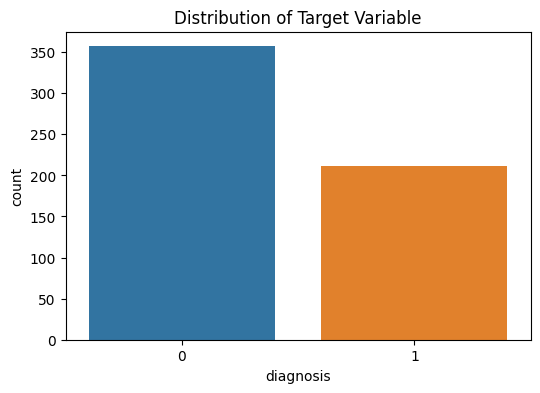

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
plt.figure(figsize=(6, 4))
sns.countplot(x='diagnosis', data=cancer_data)
plt.title('Distribution of Target Variable')
plt.show()

In [ ]:
# Pairplot for visualizing relationships between numerical features
sns.pairplot(cancer_data, hue='diagnosis')
plt.suptitle('Pairplot of Numerical Features', y=1.02)
plt.show()

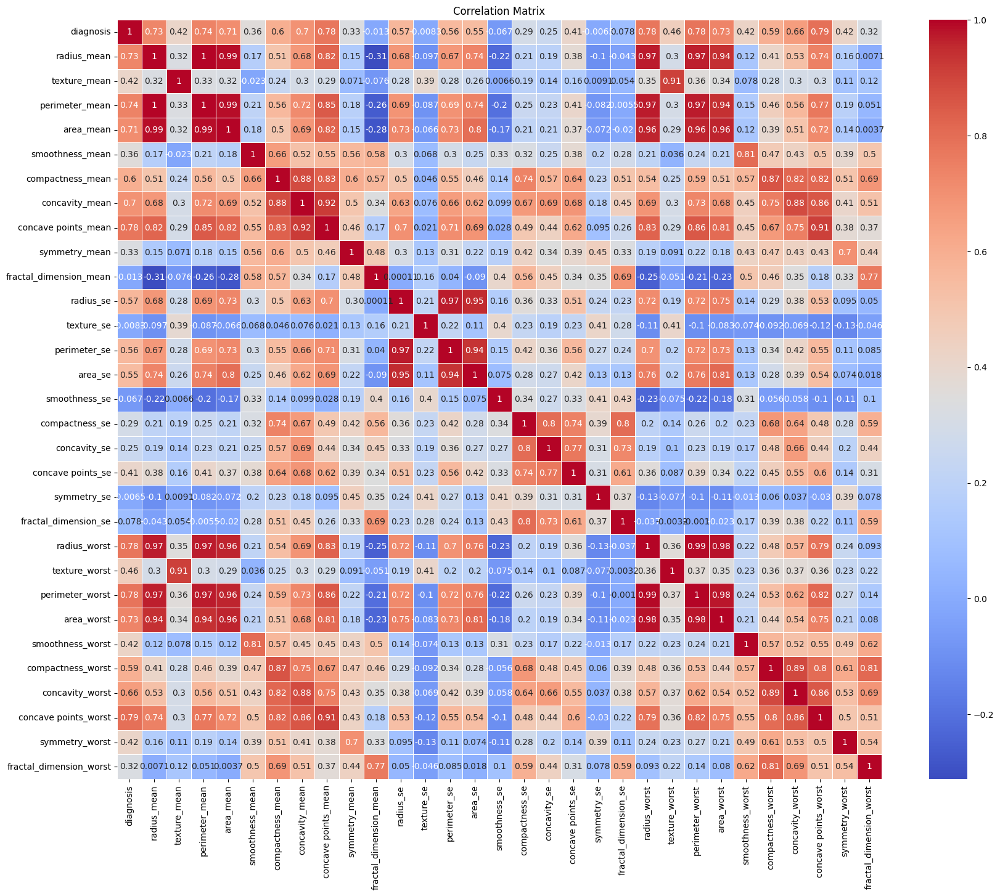

In [ ]:
 # Visualize the correlation matrix for numerical features
plt.figure(figsize=(20,16))
sns.heatmap(cancer_data.corr(), annot=True, cmap='coolwarm', linewidths=.5)
plt.title('Correlation Matrix')
plt.show()

**Split the Data into Training, validation and Testing Sets:**
Split your dataset into training and testing sets to evaluate the performance of your model.

In [ ]:
from sklearn.model_selection import train_test_split

# Split the data into training and temporary sets
X_train, X_temp, y_train, y_temp = train_test_split(X_scaled, y, test_size=0.4, random_state=2)

# Further split the temporary set into validation and test sets
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)

# Print the shapes of the sets
print("Training set shape:", X_train.shape, y_train.shape)
print("Validation set shape:", X_val.shape, y_val.shape)
print("Test set shape:", X_test.shape, y_test.shape)


Training set shape: (341, 30) (341,)
Validation set shape: (114, 30) (114,)
Test set shape: (114, 30) (114,)


**Logistic Regression Model**

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

# Create a Logistic Regression model
model = LogisticRegression(random_state=0)

In [ ]:
# Train the model on the training set
model.fit(X_train, y_train)

# Make predictions on the training set
y_train_pred = model.predict(X_train)

In [ ]:
# accuracy on the training set
training_data_accuracy = accuracy_score(y_train, y_train_pred)
print("Training Data Accuracy:", training_data_accuracy)

Training Data Accuracy: 0.9912023460410557


In [ ]:
# Make predictions on the validation set
y_val_pred = model.predict(X_val)

# Calculate accuracy on the validation set
validation_data_accuracy = accuracy_score(y_val, y_val_pred)
print("Validation Data Accuracy:", validation_data_accuracy)

Validation Data Accuracy: 0.9649122807017544


In [ ]:
# Make predictions on the test set
y_test_pred = model.predict(X_test)

# Calculate accuracy on the test set
testing_data_accuracy = accuracy_score(y_test, y_test_pred)

In [ ]:
print("Testing Data Accuracy:", testing_data_accuracy)

# Other evaluation metrics
print("Classification Report on Test Set:")
print(classification_report(y_test, y_test_pred))

print("Confusion Matrix on Test Set:")
print(confusion_matrix(y_test, y_test_pred))

Testing Data Accuracy: 0.9736842105263158
Classification Report on Test Set:
              precision    recall  f1-score   support

           0       0.96      1.00      0.98        72
           1       1.00      0.93      0.96        42

    accuracy                           0.97       114
   macro avg       0.98      0.96      0.97       114
weighted avg       0.97      0.97      0.97       114

Confusion Matrix on Test Set:
[[72  0]
 [ 3 39]]


In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

# Hyperparameter tuning using grid search
param_grid = {'C': [0.001, 0.01, 0.1, 1, 10, 100]}
grid_search = GridSearchCV(LogisticRegression(random_state=0), param_grid, cv=5)
grid_search.fit(X_train, y_train)

# Get the best parameters
best_params = grid_search.best_params_
print("Best Parameters:", best_params)

# Train the model with the best parameters
model = LogisticRegression(random_state=0, **best_params)
model.fit(X_train, y_train)

# Make predictions on the testing set
y_pred = model.predict(X_test)

# Evaluate performance
print("Accuracy:", accuracy_score(y_test, y_pred))
print("Classification Report:")
print(classification_report(y_test, y_pred))
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

Best Parameters: {'C': 10}
Accuracy: 0.956140350877193
Classification Report:
              precision    recall  f1-score   support

           0       0.96      0.97      0.97        72
           1       0.95      0.93      0.94        42

    accuracy                           0.96       114
   macro avg       0.96      0.95      0.95       114
weighted avg       0.96      0.96      0.96       114

Confusion Matrix:
[[70  2]
 [ 3 39]]


In [ ]:
# Input data for prediction
input_data = (21.16, 23.04, 137.2, 1404, 0.09428, 0.1022, 0.1097, 0.08632, 0.1769, 0.05278, 0.6917, 1.127, 4.303, 93.99, 0.004728, 0.01259, 0.01715, 0.01038, 0.01083, 0.001987, 29.17, 35.59, 188, 2615, 0.1401, 0.26, 0.3155, 0.2009, 0.2822, 0.07526)

# Convert input_data to a numpy array
data = np.asarray(input_data)

# Reshape array for predicting one data point
data_reshape = data.reshape(1, -1)

# Standardize the input data using the same scaler used for training
input_data_standardized = scaler.transform(data_reshape)

# Make prediction
prediction = model.predict(input_data_standardized)

# Print the prediction
if prediction[0] == 0:
    print("The cancer is Benign")
else:
    print("The cancer is Malignant")


The cancer is Malignant


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(


In [ ]:
input_data = (9.738,11.97,61.24,288.5,0.0925,0.04102,0,0,0.1903,0.06422,0.1988,0.496,1.218,12.26,0.00604,0.005656,0,0,0.02277,0.00322,10.62,14.1,66.53,342.9,0.1234,0.07204,0,0,0.3105,0.08151)
data = np.asarray(input_data)
data_reshape = data.reshape(1, -1)
input_data_standardized = scaler.transform(data_reshape)

prediction = model.predict(input_data_standardized)

# Print the prediction
if prediction[0] == 0:
    print("The cancer is Benign")
else:
    print("The cancer is Malignant")

The cancer is Benign


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but StandardScaler was fitted with feature names
  warnings.warn(
